In [34]:
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
import datetime
import time
import seaborn as sns
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import autoinsight as ai
#https://scikit-learn.org/stable/modules/tree.html
from sklearn import tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

In [3]:
# Refer to https://www.kaggle.com/uciml/pima-indians-diabetes-database
#df = pd.read_csv("https://raw.githubusercontent.com/mlg-2020/project1/master/diabetes.csv", delimiter=",", decimal=".")
df = pd.read_csv("diabetes.csv", delimiter=",", decimal=".")
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [4]:
# Are there any NAs or missing values in a dataset?
df.isnull().values.any()

False

In [4]:
df['Outcome'] = df['Outcome'].astype('bool') # the Outcome column has Boolean datatype  
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
Pregnancies                 768 non-null int64
Glucose                     768 non-null int64
BloodPressure               768 non-null int64
SkinThickness               768 non-null int64
Insulin                     768 non-null int64
BMI                         768 non-null float64
DiabetesPedigreeFunction    768 non-null float64
Age                         768 non-null int64
Outcome                     768 non-null bool
dtypes: bool(1), float64(2), int64(6)
memory usage: 48.9 KB


In [6]:
df.describe()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
count,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000
mean,3.845052,120.894531,69.105469,20.536458,79.799479,31.992578,0.471876,33.240885
std,3.369578,31.972618,19.355807,15.952218,115.244002,7.884160,0.331329,11.760232
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.078000,21.000000
25%,1.000000,99.000000,62.000000,0.000000,0.000000,27.300000,0.243750,24.000000
50%,3.000000,117.000000,72.000000,23.000000,30.500000,32.000000,0.372500,29.000000
75%,6.000000,140.250000,80.000000,32.000000,127.250000,36.600000,0.626250,41.000000
max,17.000000,199.000000,122.000000,99.000000,846.000000,67.100000,2.420000,81.000000


In [7]:
ai.binary_auto_insight(df, labelCol = 'Outcome', positive_class = 0)

,Outcome,Total,Outcome(%)
[Glucose<128],,,
no,109,283,38.52%
"yes, missing",391,485,80.62%


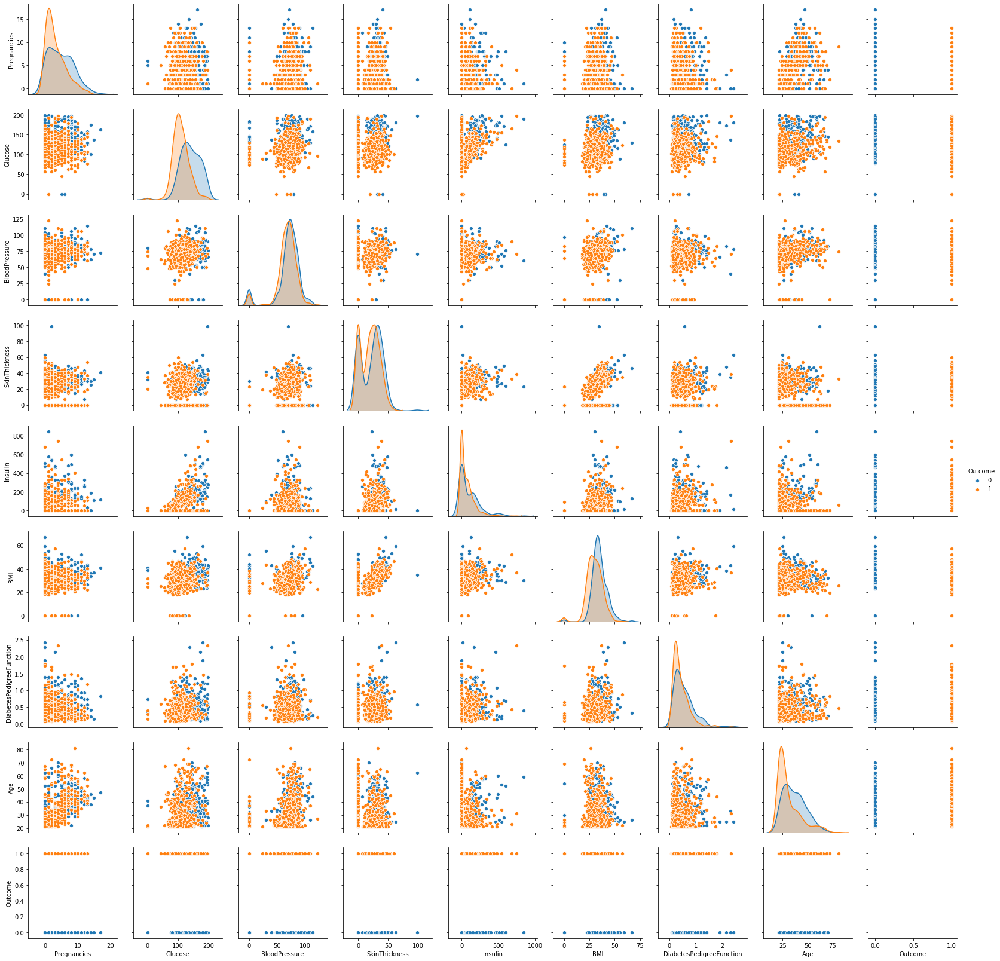

In [8]:
# Histogram of distribution and scatter plot of correlation, divided in response class "Outcome"
sns.pairplot(df, hue='Outcome')

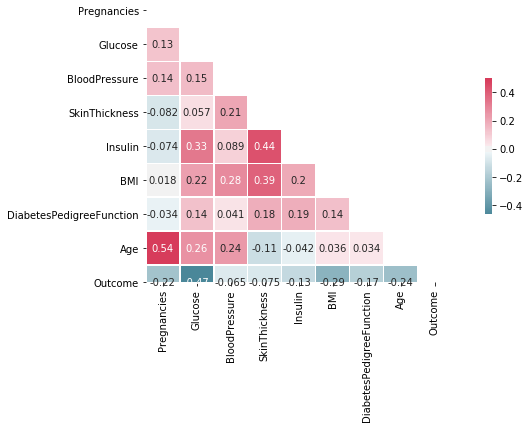

In [9]:
corr = df.corr()
cmap = sns.diverging_palette(220, 5, as_cmap=True)
# Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(12, 5))
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.5, center=0, annot = True, square=True, linewidths=.5, cbar_kws={"shrink": .5});

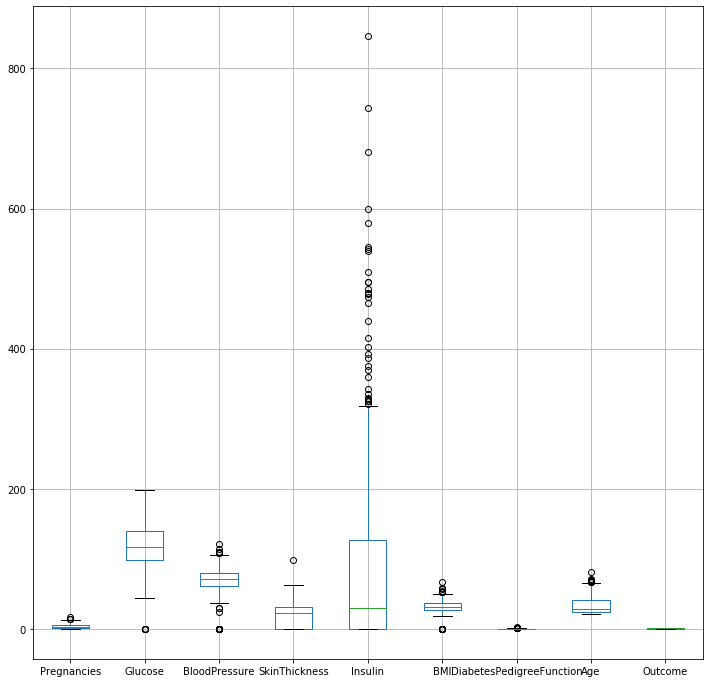

In [10]:
plt.figure(figsize=(12, 12))
df.boxplot()

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x126330a90>,
      dtype=object)

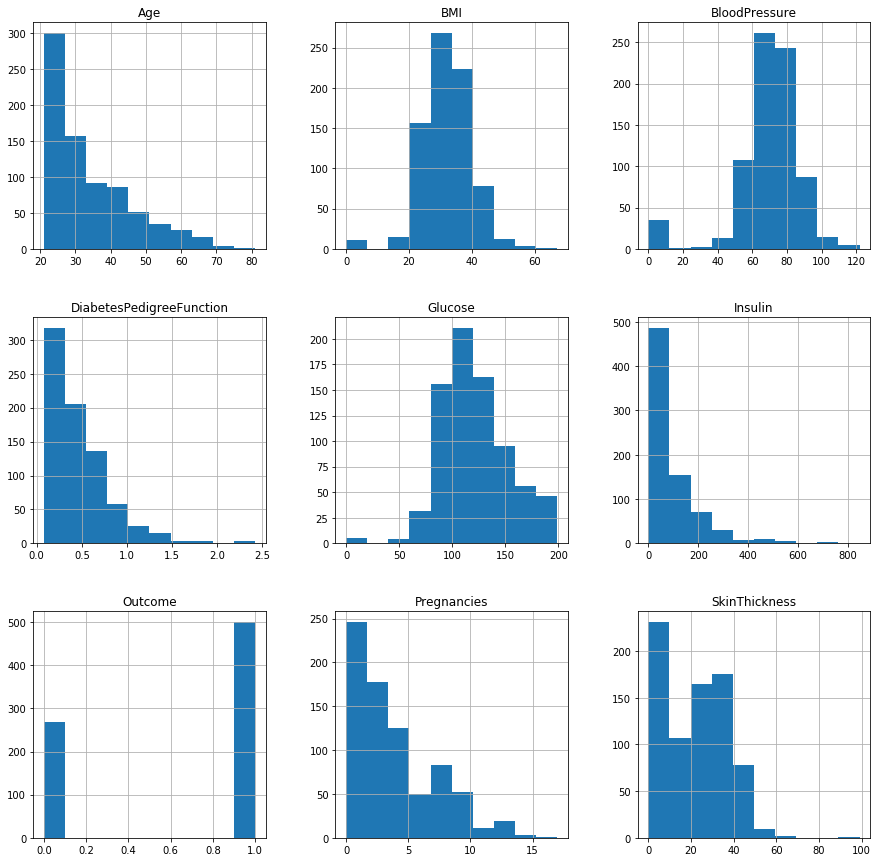

In [11]:
# Attributes normal distribution matrix
fig = plt.figure(figsize = (15,15))
ax = fig.gca()
df.hist(ax = ax)
#df.groupby('Outcome').hist(ax = ax)

In [12]:
# Skewness is a measure of the asymmetry of the probability distribution of a real-valued random variable about its mean (https://en.wikipedia.org/wiki/Skewness)
df.skew(axis = 0, skipna = True)

Pregnancies                 0.901674
Glucose                     0.173754
BloodPressure              -1.843608
SkinThickness               0.109372
Insulin                     2.272251
BMI                        -0.428982
DiabetesPedigreeFunction    1.919911
Age                         1.129597
Outcome                    -0.635017
dtype: float64

In [25]:
# Divide dataset in independent variables and response
X = df.loc[:,:"Age"]
y = df["Outcome"]

In [39]:
# Split the data into a training set and a test set for Cross Validation
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

# Create a decision tree and fit the data
dtc = tree.DecisionTreeClassifier() #random_state=0, max_depth=2)
dtc.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')

In [51]:
# Confusion matrix
y_pred = dtc.predict(X_test)
df_cm = confusion_matrix(y_test, y_pred)
df_cm

# TP FN
# FP TN
# How accurate do you classify True Positive (sick people predicted as sick)
# Sensitivity = TP / (TP + FN) 
# Error on healthy people classified as sick
# Specitivity = TN / (FP + TN) 

array([[106,  24],
       [ 24,  38]])

In [ ]:
# From the pairplot, we intuitively see that some data is not normally distributed, lets try to take the log
df['log_Pregnancies'] = np.log10(df['Pregnancies'])
df['log_BloodPressure'] = np.log10(df['BloodPressure'])
df['log_Insulin'] = np.log10(df['Insulin'])
df['log_SkinThickness'] = np.log10(df['SkinThickness'])
# Drop the non-transformed columns
df2 = df.drop(columns = ['Pregnancies', 'BloodPressure', 'Insulin', 'SkinThickness'])

/Users/martin/Library/Python/3.7/lib/python/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/Users/martin/Library/Python/3.7/lib/python/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


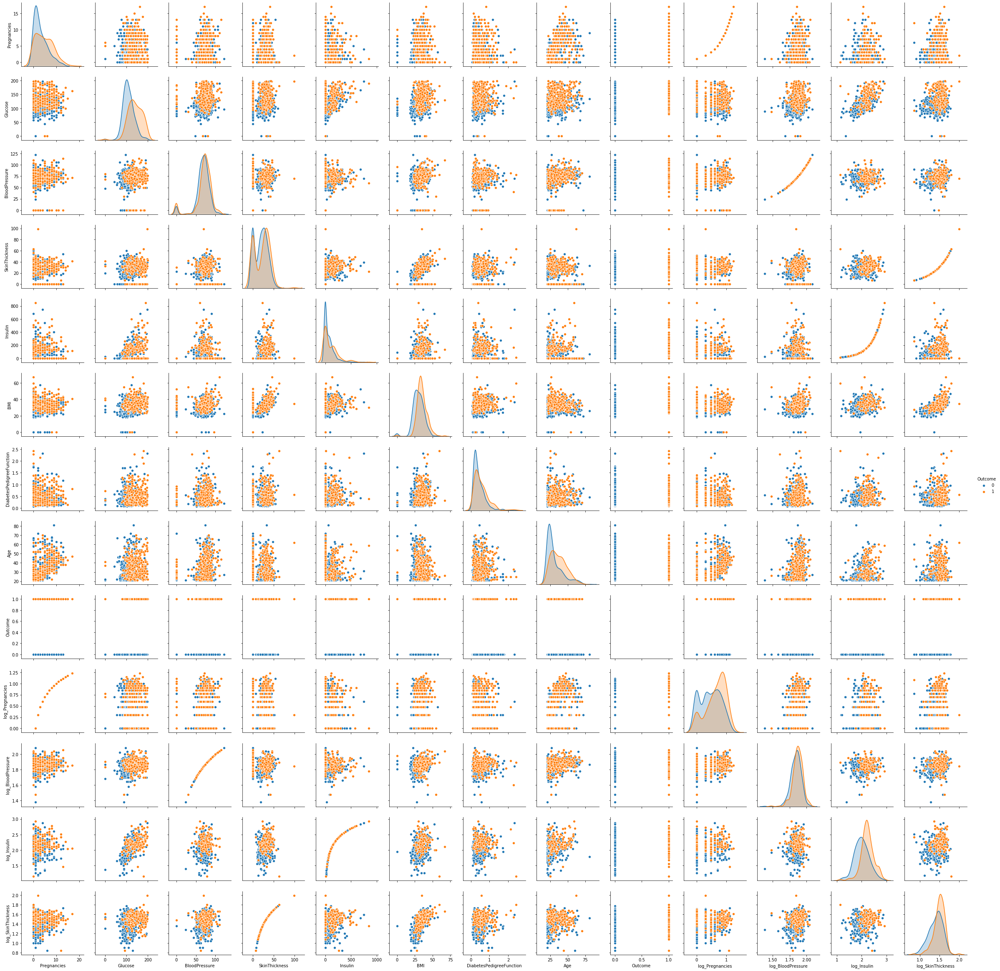

In [23]:
sns.pairplot(df, hue='Outcome')

In [24]:
df2.corr()

,Glucose,BMI,DiabetesPedigreeFunction,Age,Outcome,log_Pregnancies,log_BloodPressure,log_Insulin,log_SkinThickness
Glucose,1.000000,0.221071,0.137337,0.263514,0.466581,0.188136,0.217743,0.624036,0.203389
BMI,0.221071,1.000000,0.140647,0.036242,0.292695,0.076780,0.236905,0.254846,0.631097
DiabetesPedigreeFunction,0.137337,0.140647,1.000000,0.033561,0.173844,-0.028034,-0.005676,0.110595,0.086614
Age,0.263514,0.036242,0.033561,1.000000,0.238356,0.540036,0.326036,0.254881,0.167189
Outcome,0.466581,0.292695,0.173844,0.238356,1.000000,0.259893,0.165310,0.350499,0.262623
log_Pregnancies,0.188136,0.076780,-0.028034,0.540036,0.259893,1.000000,0.295646,0.180400,0.180120
log_BloodPressure,0.217743,0.236905,-0.005676,0.326036,0.165310,0.295646,1.000000,0.127414,0.217223
log_Insulin,0.624036,0.254846,0.110595,0.254881,0.350499,0.180400,0.127414,1.000000,0.206051
log_SkinThickness,0.203389,0.631097,0.086614,0.167189,0.262623,0.180120,0.217223,0.206051,1.000000


In [ ]:
# What about missing data? Clearly, not all people has hade pregnancies (divide by 0)